In [1]:
import matplotlib.pyplot as plt
from nomic import AtlasDataset
import numpy as np
from PIL import Image
import requests
import subprocess
import torch
import torch.nn.functional as F
from transformers import AutoTokenizer, AutoModel, AutoImageProcessor

# Load models from HuggingFace

In [2]:
tokenizer = AutoTokenizer.from_pretrained('nomic-ai/nomic-embed-text-v1.5')
text_model = AutoModel.from_pretrained('nomic-ai/nomic-embed-text-v1.5', trust_remote_code=True)
text_model.eval()
processor = AutoImageProcessor.from_pretrained("nomic-ai/nomic-embed-vision-v1.5")
vision_model = AutoModel.from_pretrained("nomic-ai/nomic-embed-vision-v1.5", trust_remote_code=True)
vision_model.eval()
print("Ready")

<All keys matched successfully>


Ready


# Load data from Nomic Atlas

In [17]:
datamap = AtlasDataset('max-nomic/observant-wigner').maps[0]
arboretum = datamap.data.df
embeddings = datamap.embeddings.latent
projected_embeddings = datamap.embeddings.projected
print("Ready")

2024-09-15 12:39:51.927 | INFO     | nomic.dataset:__init__:763 - Loading existing dataset `max-nomic/observant-wigner`.
2024-09-15 12:39:52.474 | WARNING  | nomic.data_operations:df:923 - Converting to pandas dataframe. This may materialize a large amount of data into memory.
2024-09-15 12:39:52.475 | INFO     | nomic.data_operations:_download_data:902 - Downloading data
100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2727.83it/s]
2024-09-15 12:39:52.854 | INFO     | nomic.data_operations:_load_data:872 - Loading data
100%|████████████████████████████████████████████| 5/5 [00:00<00:00, 402.90it/s]
2024-09-15 12:39:53.047 | INFO     | nomic.data_operations:_download_latent:550 - Downloading latent embeddings
100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 1614.93it/s]
2024-09-15 12:39:53.054 | INFO     | nomic.data_operations:latent:527 - Loading latent embeddings
100%|████████████████████████████████████████████| 5/5 [00:00<00:00, 266.38it/s]
20

Ready


In [18]:
!brew install imagesnap

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


==> Auto-updating Homebrew...
Adjust how often this is run with HOMEBREW_AUTO_UPDATE_SECS or disable with
HOMEBREW_NO_AUTO_UPDATE. Hide these hints with HOMEBREW_NO_ENV_HINTS (see `man brew`).
==> Auto-updated Homebrew!
Updated 2 taps (homebrew/core and homebrew/cask).
==> New Formulae
bc-gh               fierce              js-beautify         pyupgrade
bed                 firefly             jsbeautifier        rpcsvc-proto
bump-my-version     gollama             ktor                spidermonkey@115
dra                 grizzly             libblastrampoline   wush
fatal               immich-cli          oasdiff
==> New Casks
blood-on-the-clocktower-online           gauntlet
choice-financial-terminal                gitlight
crosspaste                               parallels@19
dfcf                                     photostickies
feedflow                                 retcon
flutterflow                              rize
font-departure-mono                      wealthfolio
font-ibm-p

In [21]:
# webcam photos

# mac
# !imagesnap hand.jpg

# linux
# subprocess.run(f"libcamera-still -o leaf.jpg --awb auto", shell=True)

Capturing image from device "FaceTime HD Camera"...

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


hand.jpg


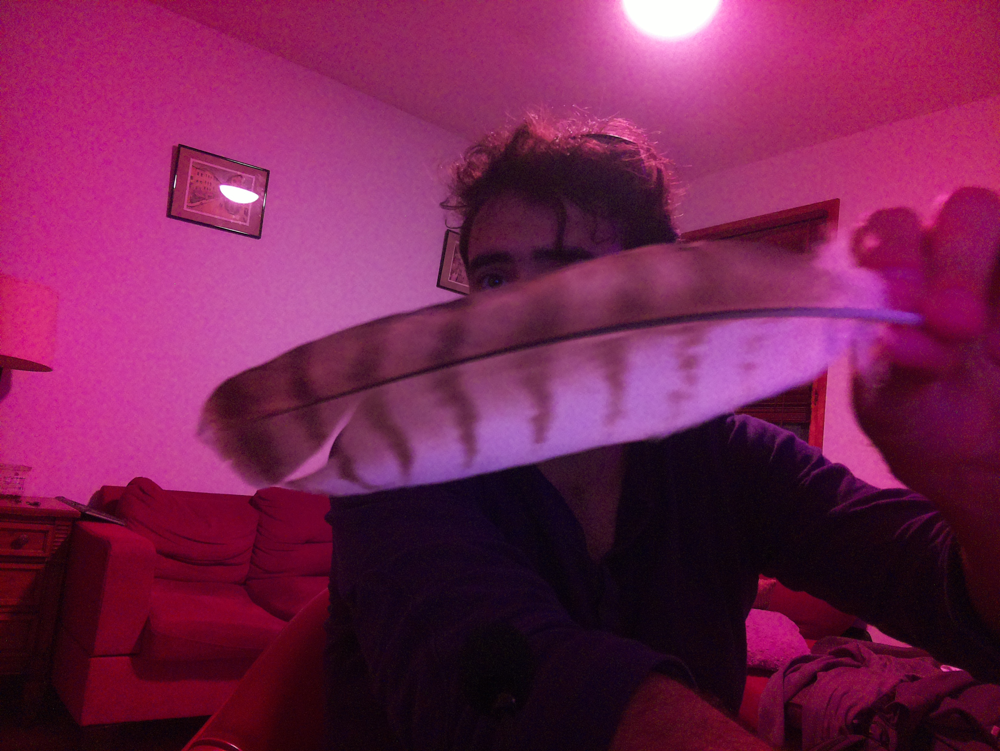

In [4]:
feather = Image.open("feather.jpg")
feather

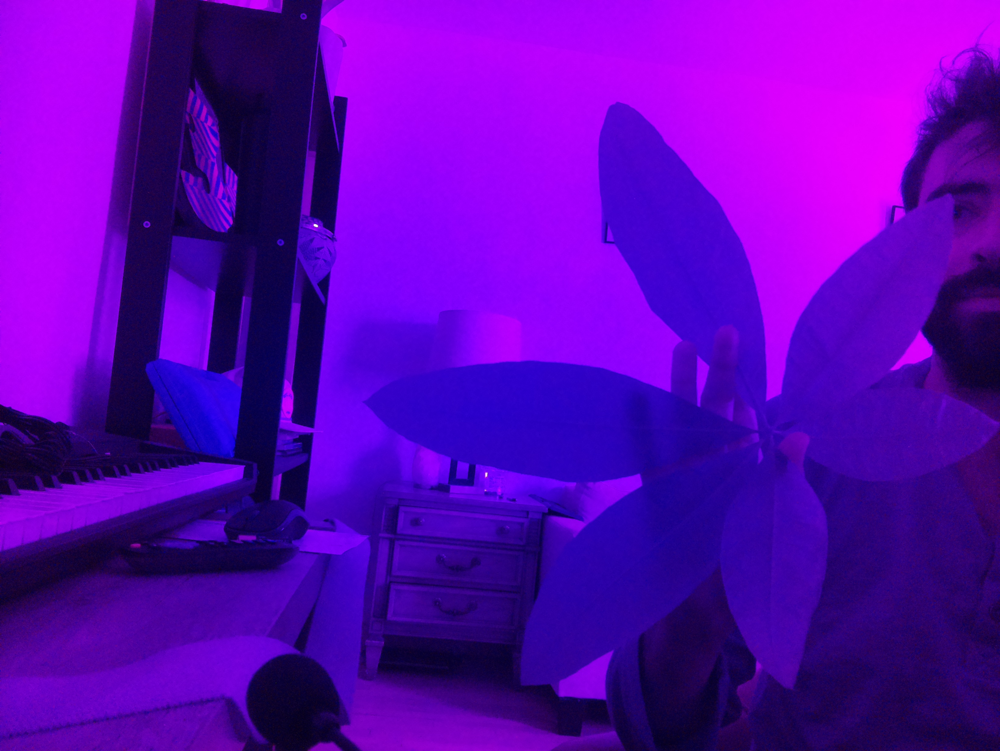

In [5]:
leaf = Image.open("leaf.jpg")
leaf

In [6]:
# Embedding functions

def embed_text(s):
    """Text embeddings with mean pooling"""
    encoded_input = tokenizer([f"search_query: {s}"], padding=True, truncation=True, return_tensors='pt')
    with torch.no_grad():
        model_output = text_model(**encoded_input)
    input_mask_expanded = encoded_input['attention_mask'].unsqueeze(-1).expand(model_output[0].size()).float()
    text_embeddings = torch.sum(model_output[0] * input_mask_expanded, 1) / torch.clamp(input_mask_expanded.sum(1), min=1e-9)
    text_embeddings = F.layer_norm(text_embeddings, normalized_shape=(text_embeddings.shape[1],))
    return F.normalize(text_embeddings).detach().numpy()
    
def embed_image(im):
    """Image embeddings"""
    inputs = processor(im, return_tensors="pt")
    img_emb = vision_model(**inputs).last_hidden_state
    return F.normalize(img_emb[:, 0]).detach().numpy()

In [7]:
# Create embeddings for text & image searches
textbird_embedding = embed_text("bird")
textbird_activation = embeddings @ textbird_embedding.T
textplant_embedding = embed_text("plant")
textplant_activation = embeddings @ textplant_embedding.T

feather_embedding = embed_image(feather)
feather_activation = embeddings @ feather_embedding.T
leaf_embedding = embed_image(leaf)
leaf_activation = embeddings @ leaf_embedding.T

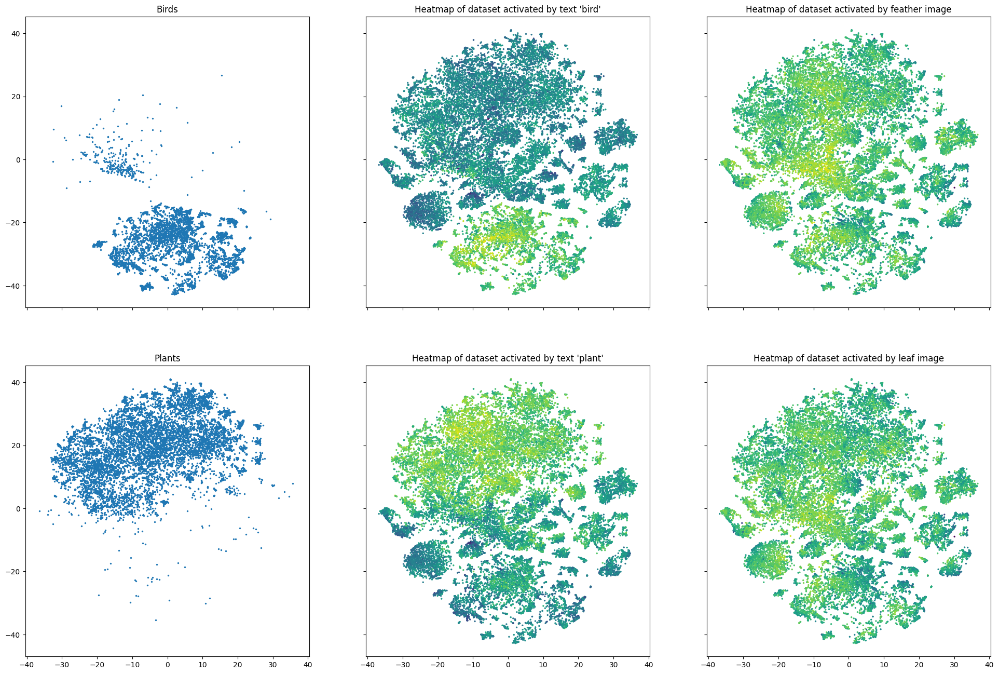

In [8]:
fig, ax = plt.subplots(2, 3, figsize=(24,16), sharex=True, sharey=True)
ax[0,0].scatter(projected_embeddings.loc[arboretum['class']=='Aves'].x, -projected_embeddings.loc[arboretum['class']=='Aves'].y, s=2)
ax[0,0].set_title("Birds")
ax[0,1].scatter(projected_embeddings.x, -projected_embeddings.y, s=2, c=textbird_activation)
ax[0,1].set_title("Heatmap of dataset activated by text 'bird'")
ax[0,2].scatter(projected_embeddings.x, -projected_embeddings.y, s=2, c=feather_activation)
ax[0,2].set_title("Heatmap of dataset activated by feather image")
ax[1,0].scatter(projected_embeddings.loc[arboretum['class']=='Magnoliopsida'].x, -projected_embeddings.loc[arboretum['class']=='Magnoliopsida'].y, s=2)
ax[1,0].set_title("Plants")
ax[1,1].scatter(projected_embeddings.x, -projected_embeddings.y, s=2, c=textplant_activation)
ax[1,1].set_title("Heatmap of dataset activated by text 'plant'")
ax[1,2].scatter(projected_embeddings.x, -projected_embeddings.y, s=2, c=leaf_activation)
ax[1,2].set_title("Heatmap of dataset activated by leaf image")
plt.show()

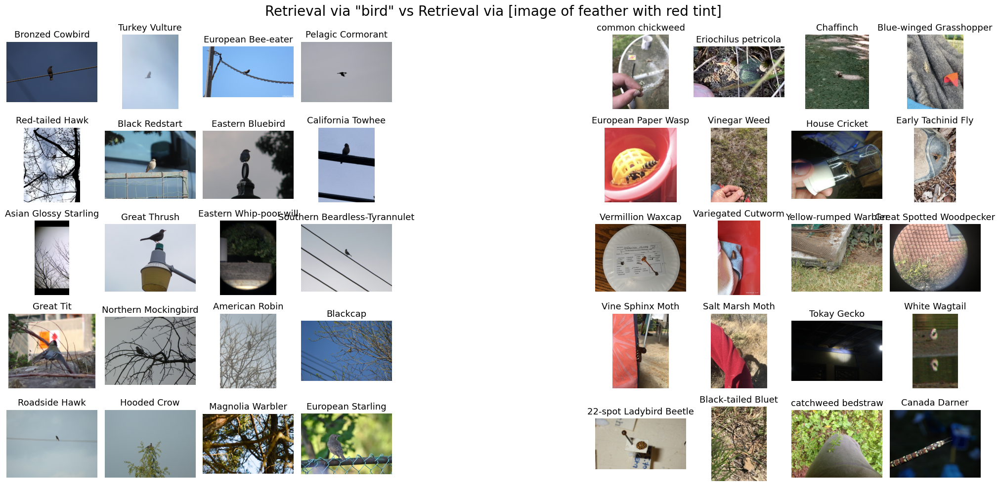

In [12]:
fig, axes = plt.subplots(5, 10, figsize=(20,10))
fig.suptitle("Retrieval via \"bird\" vs Retrieval via [image of feather with red tint]", fontsize=20)
textdf = arboretum.loc[np.argsort(textbird_activation.flatten())[-20:]]
imdf = arboretum.loc[np.argsort(feather_activation.flatten())[-20:]]
for i in range(5):
    for j in range(4):
        row = textdf.iloc[4*i+j]
        ax = axes[i,j]
        ax.set_title(row.common_name, fontsize=13)
        im=Image.open(requests.get(row.photo_url, stream=True).raw)
        ax.imshow(im)
        ax.axis("off")
    for j in range(4):
        row = imdf.iloc[4*i+j]
        ax = axes[i,j+6]
        ax.set_title(row.common_name, fontsize=13)
        im=Image.open(requests.get(row.photo_url, stream=True).raw)
        ax.imshow(im)
        ax.axis("off")
    axes[i,4].axis("off")
    axes[i,5].axis("off")
plt.tight_layout()
plt.show()

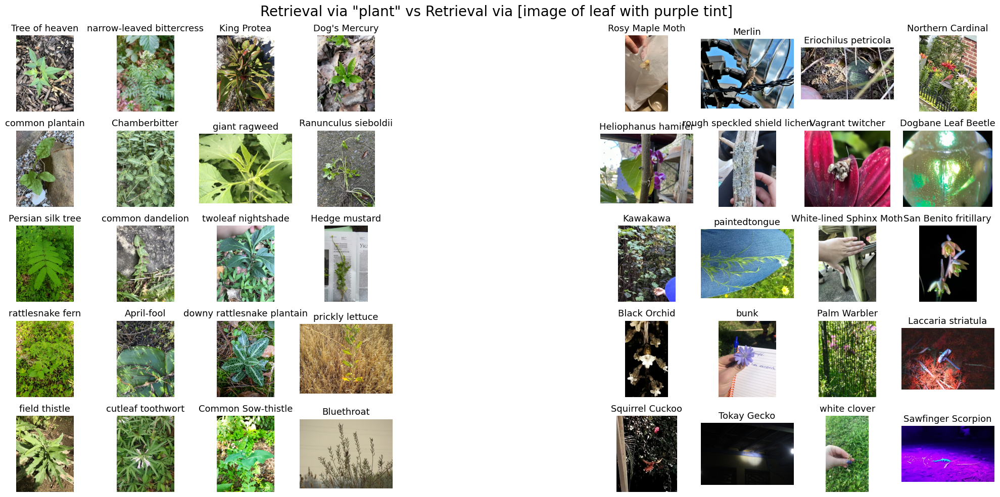

In [13]:
fig, axes = plt.subplots(5, 10, figsize=(20,10))
fig.suptitle("Retrieval via \"plant\" vs Retrieval via [image of leaf with purple tint]", fontsize=20)
textdf = arboretum.loc[np.argsort(textplant_activation.flatten())[-20:]]
imdf = arboretum.loc[np.argsort(leaf_activation.flatten())[-20:]]
for i in range(5):
    for j in range(4):
        row = textdf.iloc[4*i+j]
        ax = axes[i,j]
        ax.set_title(row.common_name, fontsize=13)
        im=Image.open(requests.get(row.photo_url, stream=True).raw)
        ax.imshow(im)
        ax.axis("off")
    for j in range(4):
        row = imdf.iloc[4*i+j]
        ax = axes[i,j+6]
        ax.set_title(row.common_name, fontsize=13)
        im=Image.open(requests.get(row.photo_url, stream=True).raw)
        ax.imshow(im)
        ax.axis("off")
    axes[i,4].axis("off")
    axes[i,5].axis("off")
plt.tight_layout()
plt.show()

# Looking for anomalies

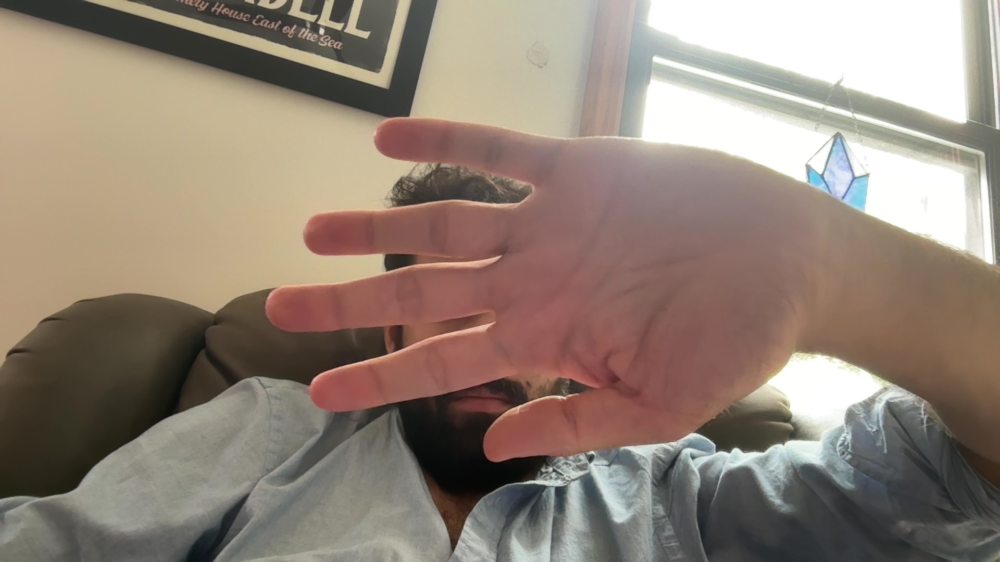

In [23]:
hand = Image.open("hand.jpg")
hand

In [24]:
texthand_embedding = embed_text("hand")
texthand_activation = embeddings @ texthand_embedding.T
hand_embedding = embed_image(hand)
hand_activation = embeddings @ hand_embedding.T

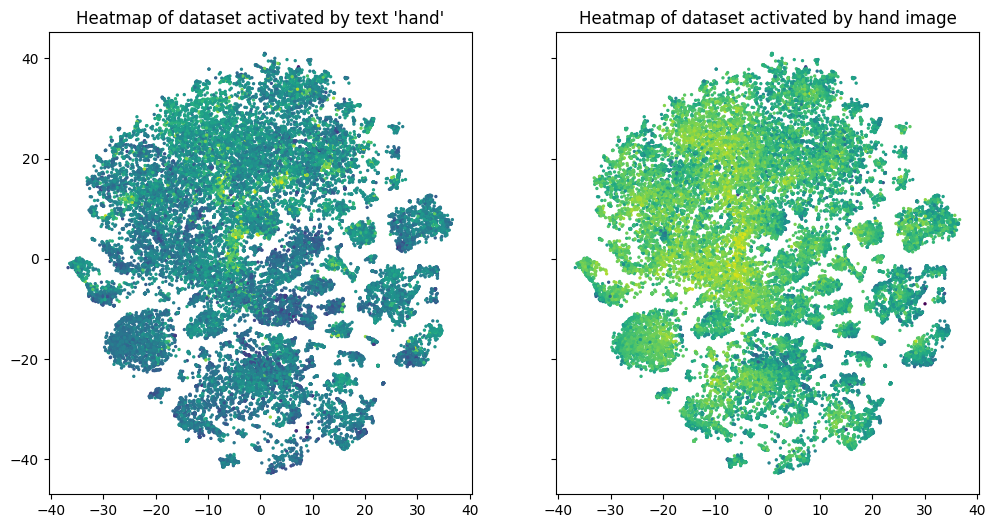

In [25]:
fig, ax = plt.subplots(1, 2, figsize=(12,6), sharex=True, sharey=True)
ax[0].scatter(projected_embeddings.x, -projected_embeddings.y, s=2, c=texthand_activation)
ax[0].set_title("Heatmap of dataset activated by text 'hand'")
ax[1].scatter(projected_embeddings.x, -projected_embeddings.y, s=2, c=hand_activation)
ax[1].set_title("Heatmap of dataset activated by hand image")
plt.show()

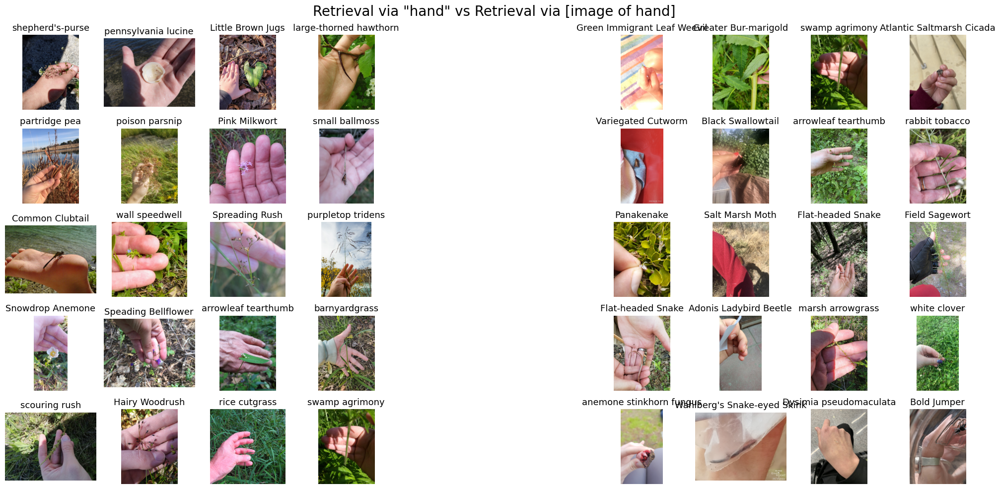

In [26]:
fig, axes = plt.subplots(5, 10, figsize=(20,10))
fig.suptitle("Retrieval via \"hand\" vs Retrieval via [image of hand]", fontsize=20)
textdf = arboretum.loc[np.argsort(texthand_activation.flatten())[-20:]]
imdf = arboretum.loc[np.argsort(hand_activation.flatten())[-20:]]
for i in range(5):
    for j in range(4):
        row = textdf.iloc[4*i+j]
        ax = axes[i,j]
        ax.set_title(row.common_name, fontsize=13)
        im=Image.open(requests.get(row.photo_url, stream=True).raw)
        ax.imshow(im)
        ax.axis("off")
    for j in range(4):
        row = imdf.iloc[4*i+j]
        ax = axes[i,j+6]
        ax.set_title(row.common_name, fontsize=13)
        im=Image.open(requests.get(row.photo_url, stream=True).raw)
        ax.imshow(im)
        ax.axis("off")
    axes[i,4].axis("off")
    axes[i,5].axis("off")
plt.tight_layout()
plt.show()